## Training and evaluation of different models

#### Import libraries and external functions

Only for notebooks

In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors


import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.parameter import Parameter

from modules.utils import init_device
from modules.architectures import *
from modules.test import compute_rmse_healpix
from modules.plotting import plot_rmses
from modules.full_pipeline import load_data_split, WeatherBenchDatasetXarrayHealpixTemp, \
                                  train_model_2steps, create_iterative_predictions_healpix_temp, \
                                  compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple
from modules.data import hp_to_equiangular
from modules.mail import send_info_mail


import warnings
warnings.filterwarnings("ignore")

In [2]:
#num_epoch = 0

In [24]:
model_path = '../data/healpix/models/'
model_name_epochs = 'all_const_len2_delta_6_architecture_loss_v0_8steps_variation1_residual_l3_long_connections_per_epoch'
#model_name = model_path + model_name_epochs + '_epoch_{}.h5'.format(num_epoch)


Define paths and create directories if required

In [25]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"

prediction_path = '../data/healpix/predictions/'

if not os.path.isdir(model_save_path):
    os.mkdir(model_save_path)


Define constants and load data

In [26]:
chunk_size = 521

train_years = ('1990', '2012')#('1979', '2012')
val_years = ('2013', '2016')
test_years = ('2017', '2018')

nodes = 12*16*16
max_lead_time = 5*24
nb_timesteps = 2

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="2"
gpu = [0]
num_workers = 10
pin_memory = True

nb_epochs = 2
learning_rate = 8e-3

obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
rmses_weyn = xr.open_dataset(datadir + 'metrics/rmses_weyn.nc')

#### Data

Load data, define dynamic dataset and separate into train, validation and test

In [27]:
ds_train, ds_valid, ds_test = load_data_split(input_dir, train_years, val_years, test_years, chunk_size)

In [28]:
constants = xr.open_dataset(f'{input_dir}constants/constants_5.625deg_standardized.nc')

orog = constants['orog']
lsm = constants['lsm']
lats = constants['lat2d']
slt = constants['slt']

num_constants = len([orog, lats, lsm, slt])

train_mean_ = xr.open_mfdataset(f'{input_dir}mean_train_features_dynamic.nc')
train_std_ = xr.open_mfdataset(f'{input_dir}std_train_features_dynamic.nc')

Define model parameters

In [29]:
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

Generate dataloader

#### Model

Define model, train and evaluate train and validation losses



In [30]:
batch_size = 70
epochs = 10

In [31]:
constants_tensor = torch.tensor(xr.merge([orog, lats, lsm, slt], compat='override').to_array().values, \
                            dtype=torch.float)

# standardize 
constants_tensor = (constants_tensor - torch.mean(constants_tensor, dim=1).view(-1,1).expand(4, 3072)) / \
                    torch.std(constants_tensor, dim=1).view(-1,1).expand(4, 3072)

#### Test 

Define test dataloader, generate predictions and evaluate loss

In [32]:
# Testing data
testing_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_test, out_features=out_features,
                                                  len_sqce=len_sqce, delta_t=delta_t, years=test_years, 
                                                  nodes=nodes, nb_timesteps=nb_timesteps, 
                                                  mean=train_mean_, std=train_std_, 
                                                  max_lead_time=max_lead_time)



Loading data to RAM...
Time: 2.21s


### THIS NEEDS TO BE MODIFIED ACCORDING TO THE CHOSEN ARCHITECTURE! 

In [16]:
#UNetSphericalHealpixResidualLongConnections

In [17]:
#UNetSphericalHealpixResidualShort3LevelsOnlyEncoder

Processing lead time 20 out of 20Z500 - 0: 94.70386829903354
T850 - 0: 0.9089565301960583


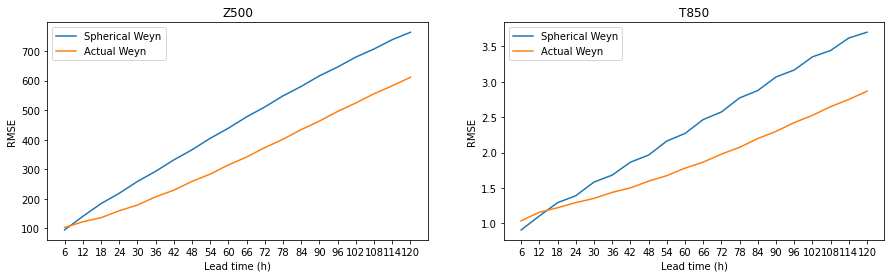

Processing lead time 20 out of 20Z500 - 0: 97.05848976615354
T850 - 0: 0.8584320579666227


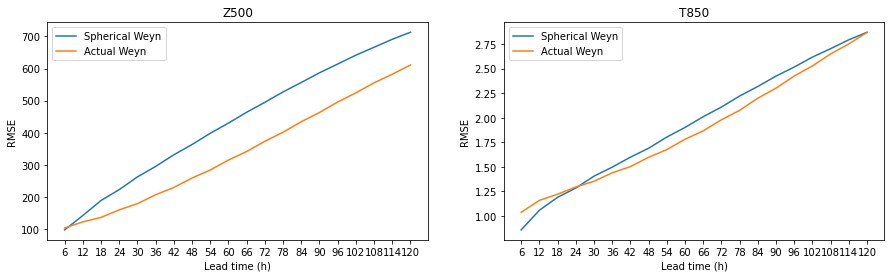

Processing lead time 18 out of 20

In [ ]:
for ep in range(5):
    model_name = model_path + model_name_epochs + '_epoch_{}.h5'.format(ep)
    #architecture_name = "debug_loading_model
    description = model_name_epochs + '_epoch_{}'.format(ep)
    
    pred_save_path = datadir + "predictions/" + model_name_epochs + '/'
    
    if not os.path.isdir(pred_save_path):
        os.mkdir(pred_save_path)

    model_filename = model_save_path + description + ".h5"
    pred_filename = pred_save_path +  description + ".nc"
    rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'
    
    
    

    metrics_path = '../data/healpix/metrics/'
    figures_path = '../data/healpix/figures/' + description + '/'
    
    if not os.path.isdir(figures_path):
        os.mkdir(figures_path)

    # load model
    spherical_unet_new2 = UNetSphericalHealpixResidualLongConnections(N=nodes, in_channels=in_features*len_sqce, out_channels=out_features, kernel_size=3)
    state_to_load = torch.load(model_name)
    
    own_state = spherical_unet_new2.state_dict()
    for name, param in state_to_load.items():
        if name not in own_state:
            if '.'.join(name.split('.')[1:]) not in own_state:
            #own_state[name] = param
                print(name)
            else:
                n = name
                name = '.'.join(n.split('.')[1:])
                
            #continue
        if isinstance(param, Parameter):
            # backwards compatibility for serialized parameters
            param = param.data
        own_state[name].copy_(param)
        
    spherical_unet_new2, device = init_device(spherical_unet_new2, gpu=gpu)
    
    # compute predictions
    predictions2, lead_times, times, nodes, out_lat, out_lon = \
    create_iterative_predictions_healpix_temp(spherical_unet_new2, \
                                              device, testing_ds, constants_tensor.transpose(1,0))
    # save predictions
    das = [];
    lev_idx = 0
    for var in ['z', 't']:       
        das.append(xr.DataArray(
            predictions2[:, :, :, lev_idx],
            dims=['lead_time', 'time', 'node'],
            coords={'lead_time': lead_times, 'time': times[:predictions2.shape[1]], 'node': np.arange(nodes)},
            name=var
        ))
        lev_idx += 1

    prediction_ds_new2 = xr.merge(das)
    prediction_ds_new2 = prediction_ds_new2.assign_coords({'lat': out_lat, 'lon': out_lon})
    
    prediction_ds_new2.to_netcdf(pred_filename)
    
    # load observations
    obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords')
    obs = obs.isel(time=slice(6,prediction_ds_new2.time.shape[0]+6))
    
    # compute RMSE
    rmse = compute_rmse_healpix(prediction_ds_new2, obs).load()
    rmse.to_netcdf(rmse_filename)
    
    # plot RMSE
    print('Z500 - 0:', rmse.z.values[0])
    print('T850 - 0:', rmse.t.values[0])

    plot_rmses(rmse, rmses_weyn.rename({'z500':'z', 't850':'t'}).isel(lead_time=list(range(20))), lead_time=6)

    #del spherical_unet
    #del prediction_ds, rmse
    torch.cuda.empty_cache()

#### Generate plots for evaluation

In [29]:
resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

#obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords')
#pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords')
#obs = obs.isel(time=slice(6,pred.time.shape[0]+6))

Compute errors

In [30]:
#obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
#predc = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})
#obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [31]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(prediction_ds_new2, obs)
print(time.time() - t)

loading data
time to load data:  11.386347532272339
time mean obs  35.206897258758545
time mean pred  37.02480506896973
time std obs  57.341201066970825
time std pred  63.61402869224548
time cov  84.00076103210449
time corre_map  0.007431983947753906
time rbias map  39.742859840393066
time rsd map  0.0026481151580810547
time rmse map  37.91462326049805
394.16786456108093


In [32]:
metrics_path + 'rmse_' + description + '.nc'

'../data/healpix/metrics/rmse_all_const_len2_delta_6_architecture_loss_v0_8steps_variation0_residual_only_enc_l3_per_epoch_restart9__epoch_1.nc'

In [33]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

In [34]:
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + description + '.nc')

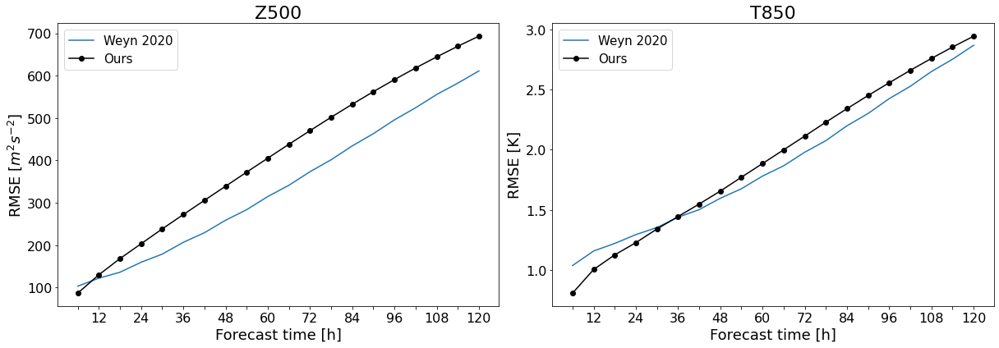

In [35]:
plot_benchmark_simple(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

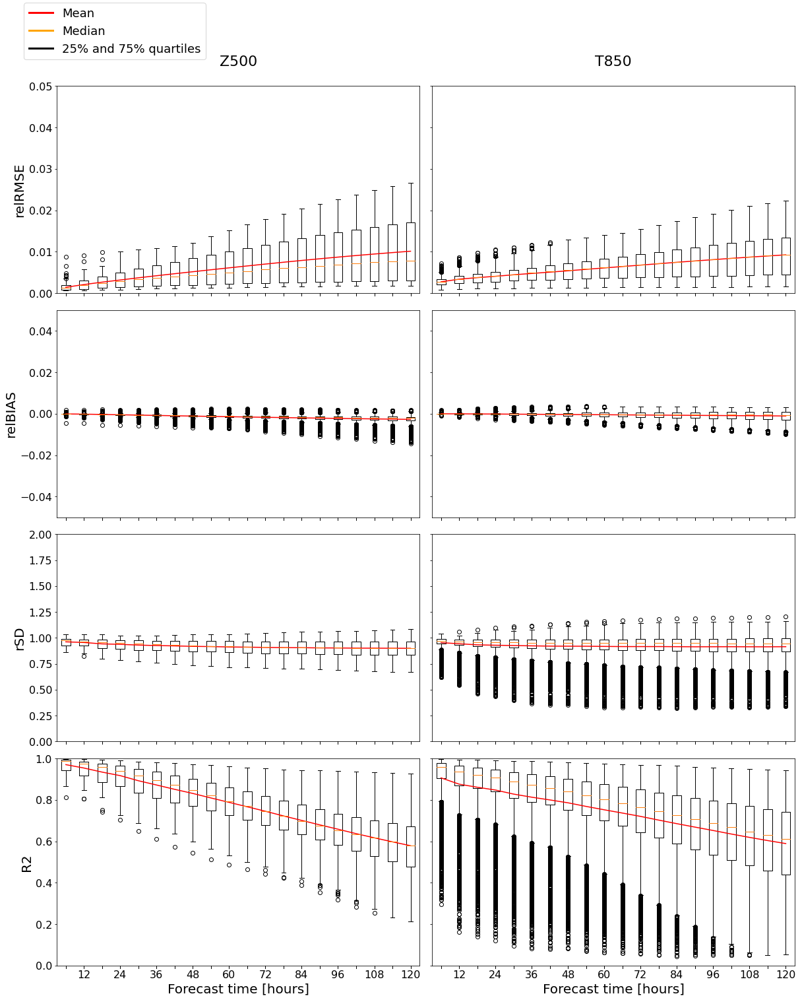

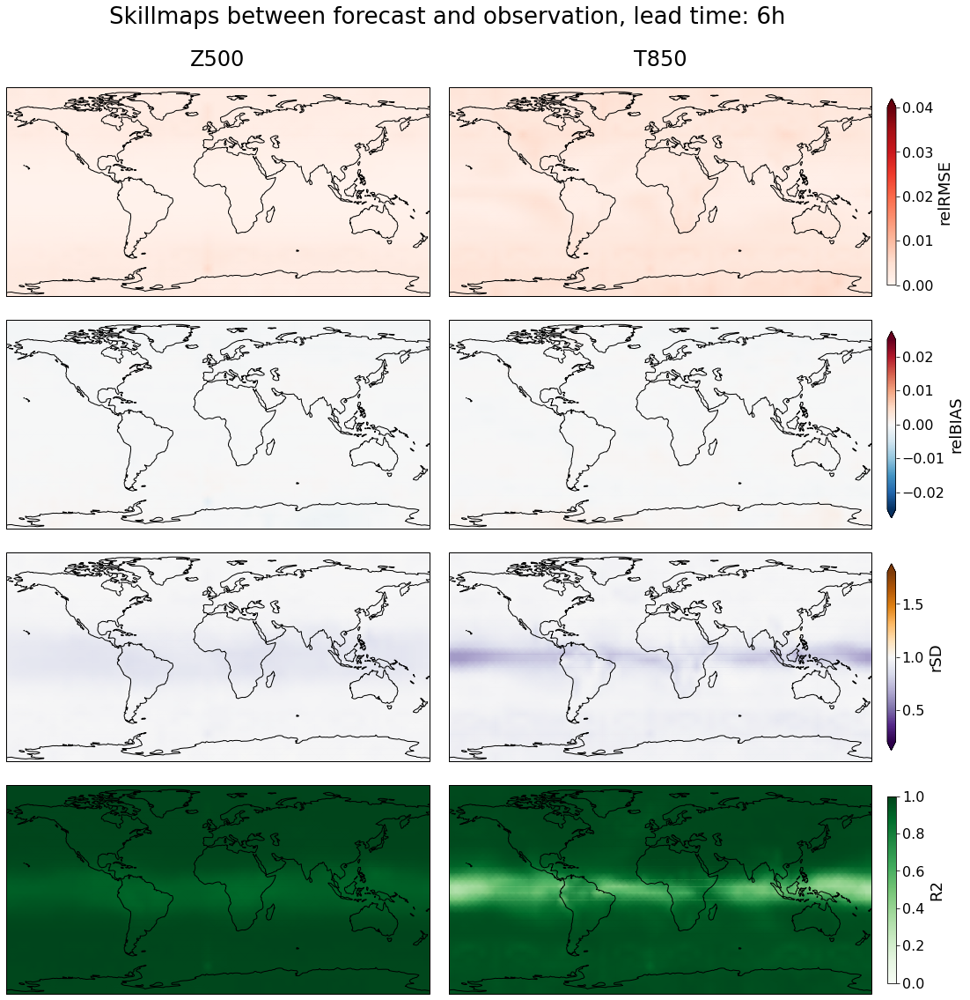

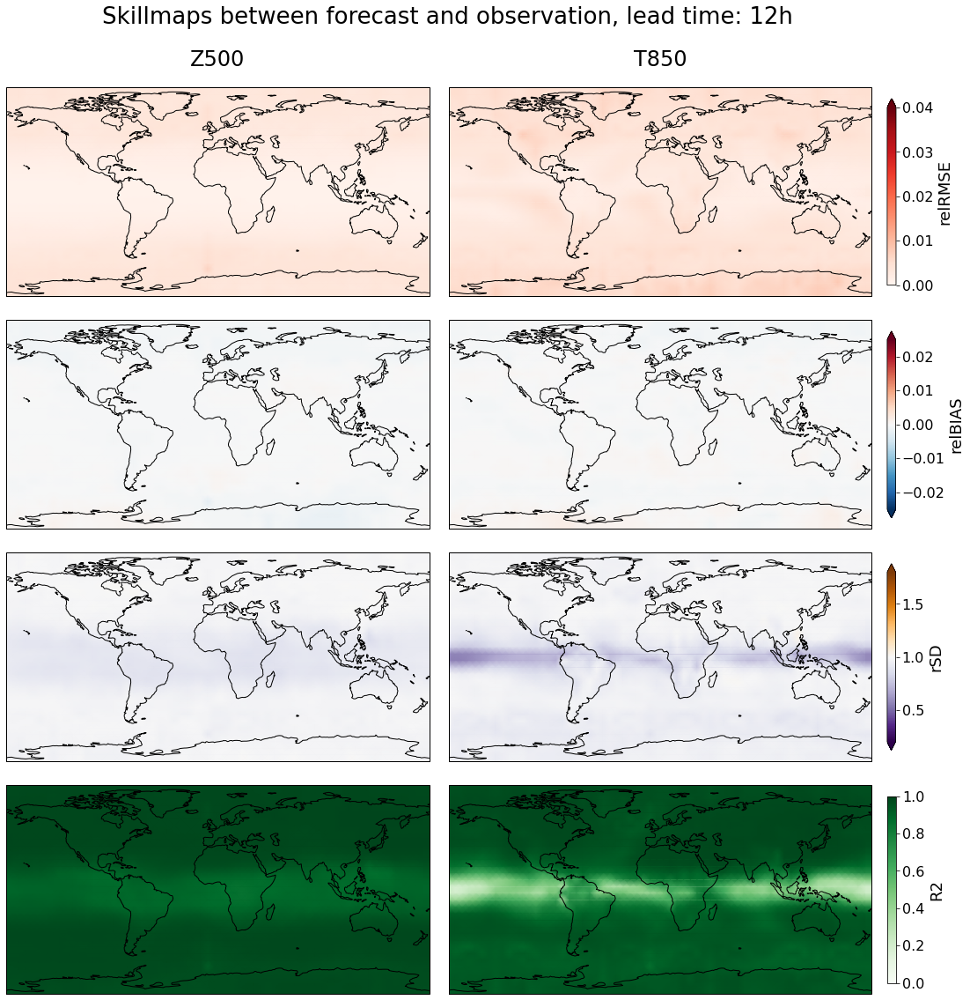

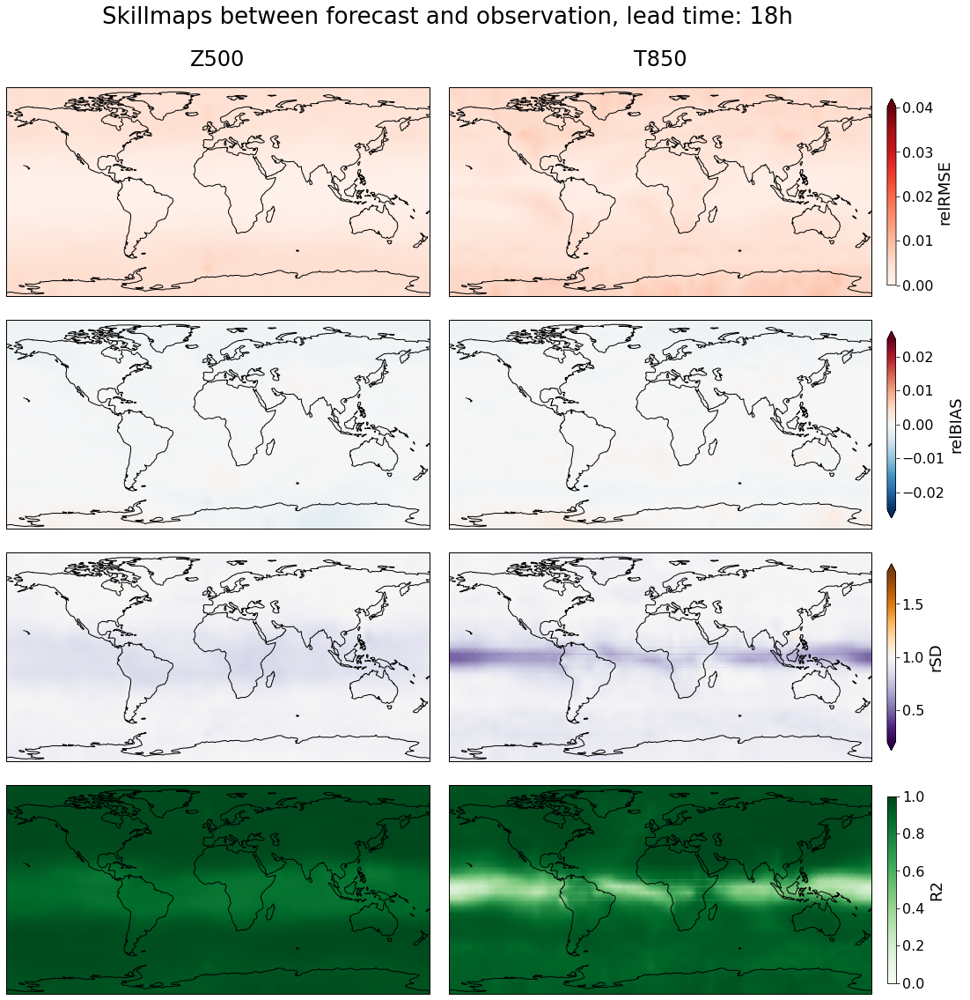

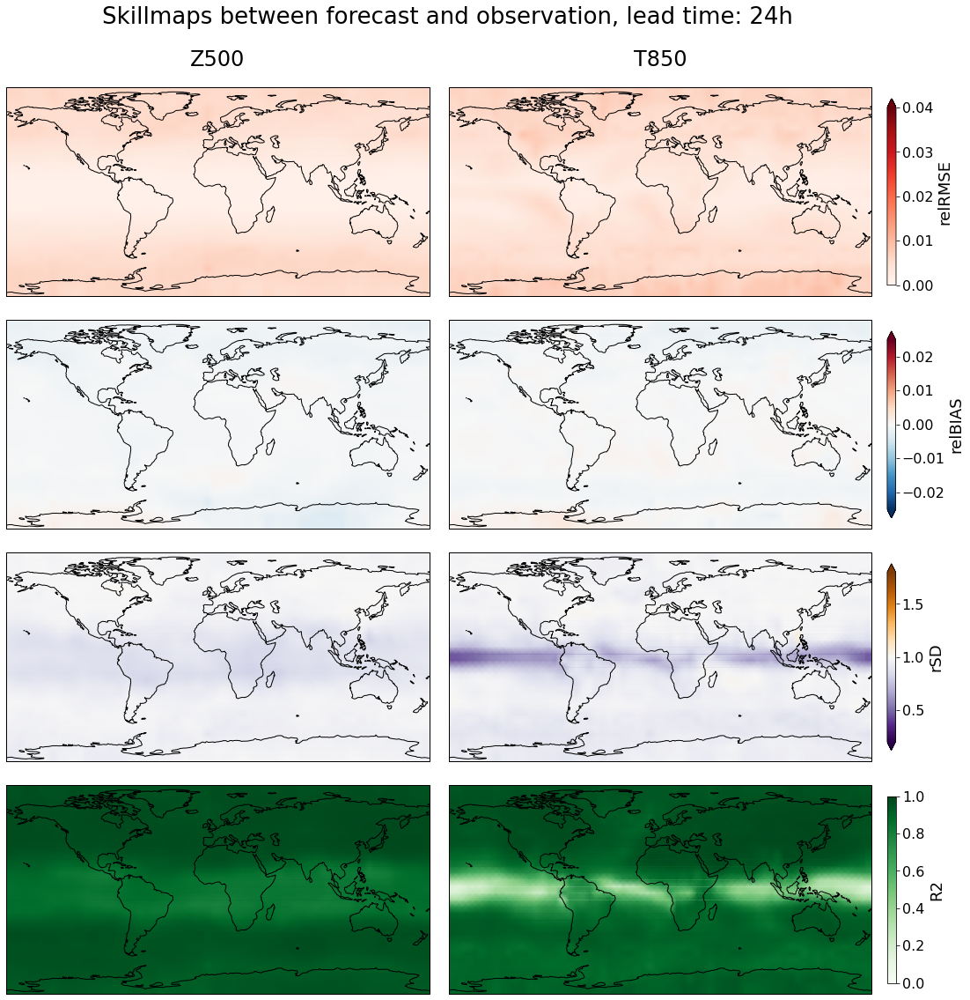

...

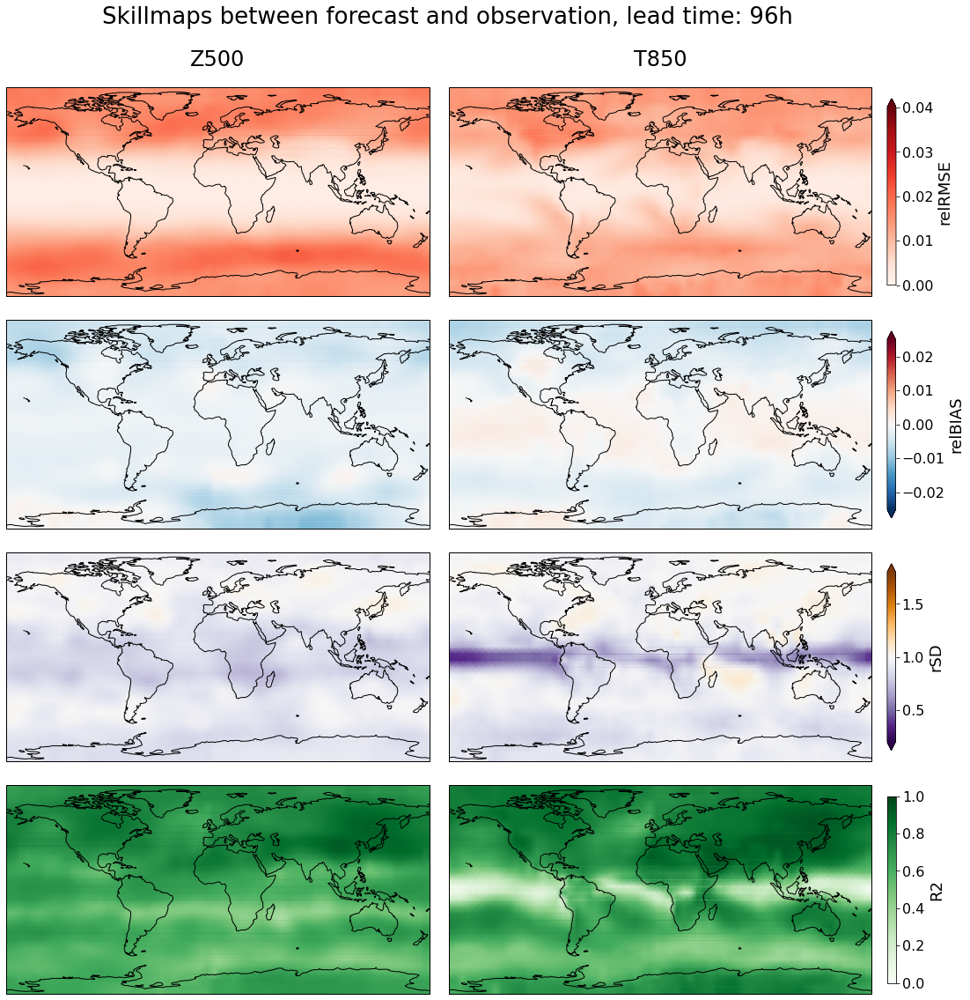

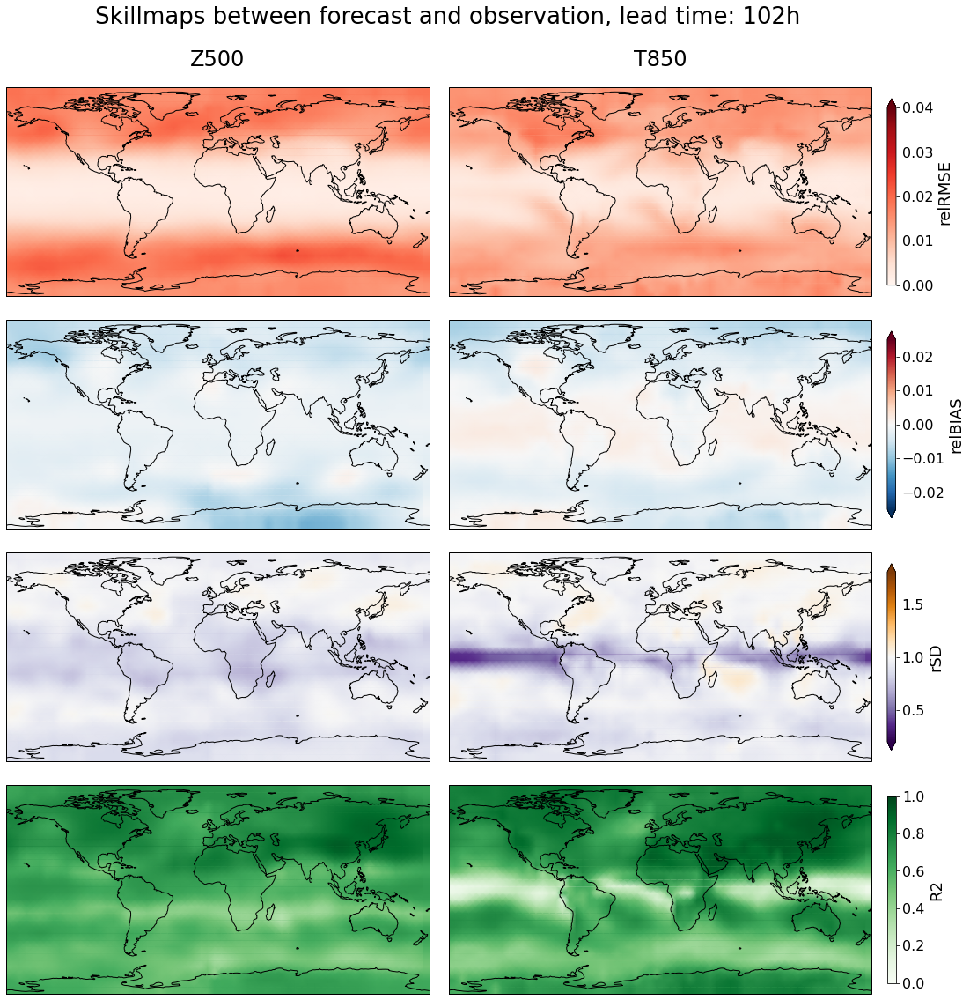

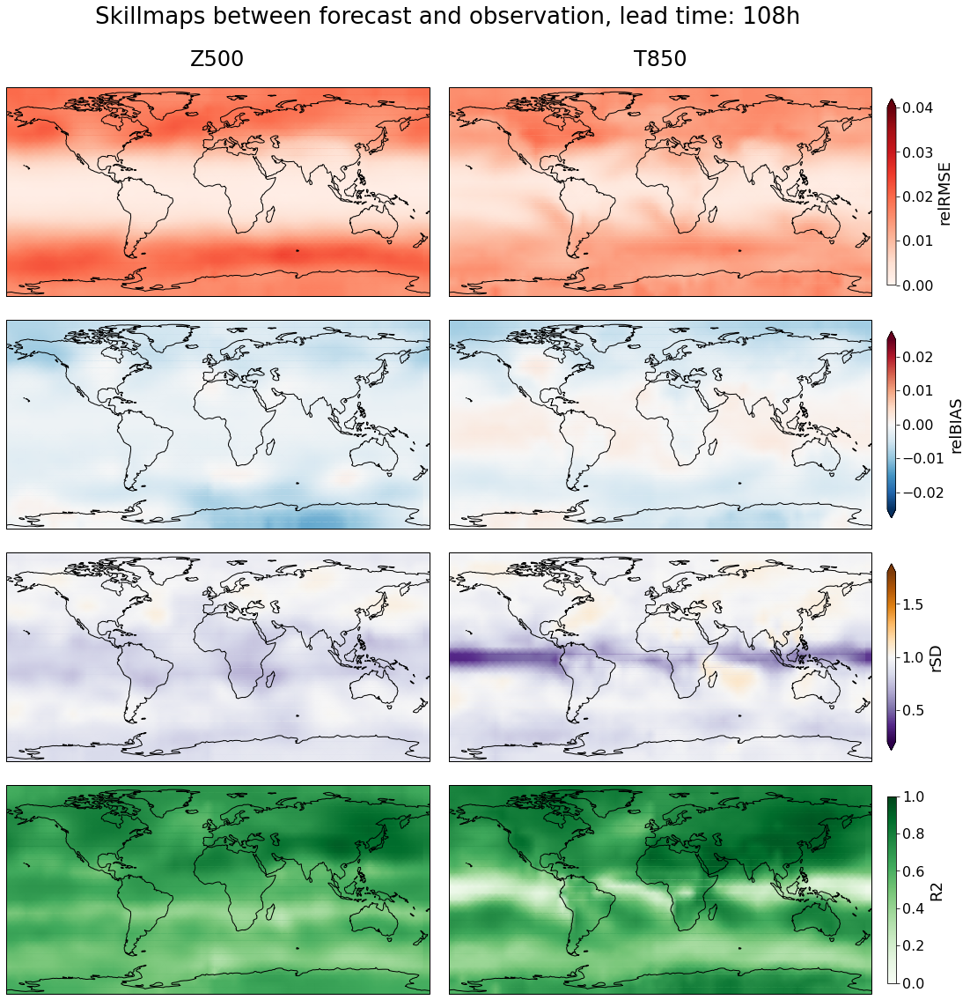

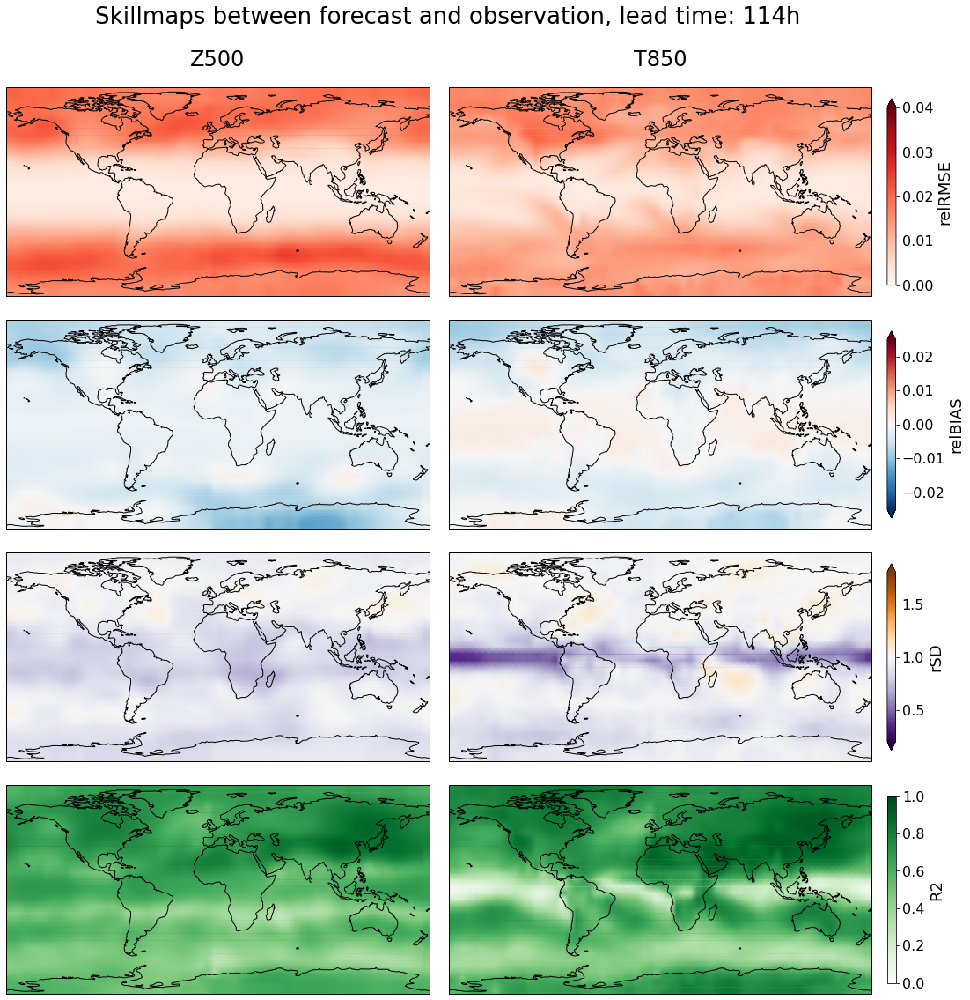

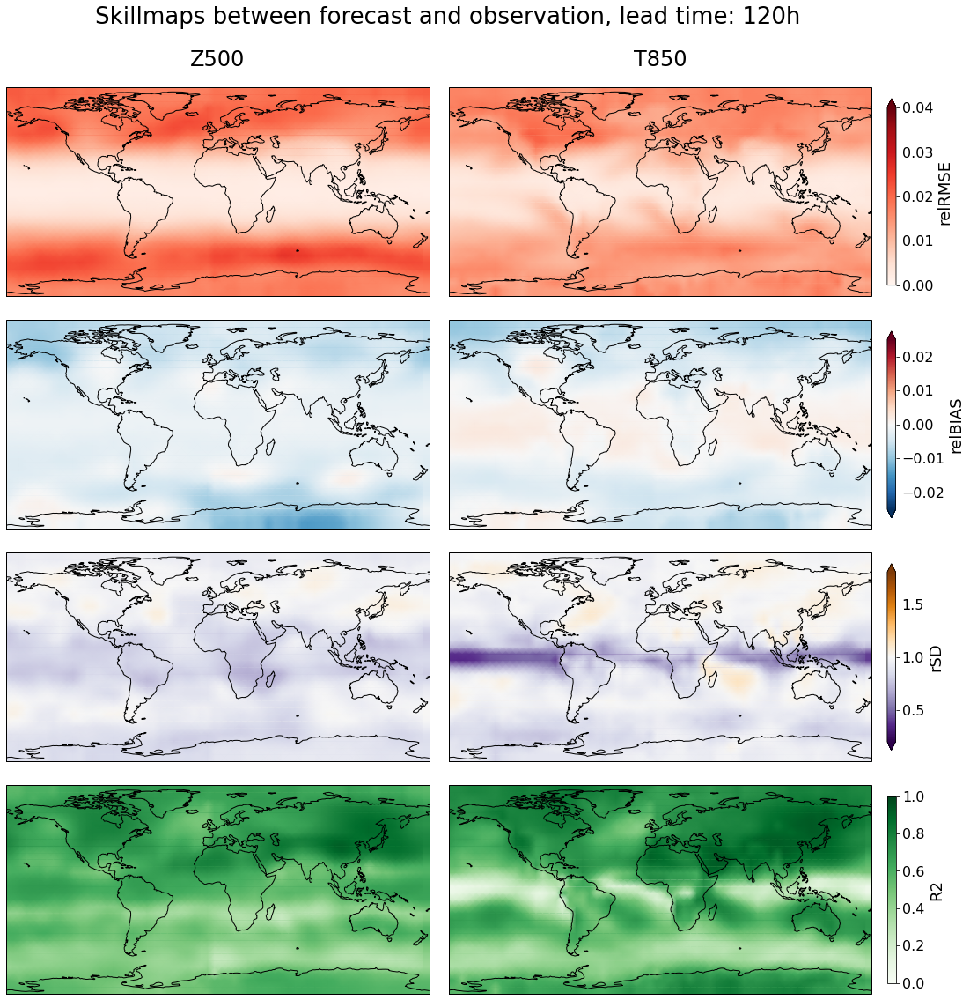

In [36]:
plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description, lead_times, 
                    output_dir=figures_path, title=False)

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description, lead_times, resolution, 
               output_dir=figures_path)

Climatology Hovmoller

In [37]:
monthly_mean = prediction_ds_new2.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

In [38]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

In [39]:
predictions_vals = {'pred_z': pred_z, 'pred_t': pred_t,'obs_z': obs_z,'obs_t': obs_t}
val_limits = {'vmin_z':vmin_z, 'vmax_z':vmax_z, 'vmin_t':vmin_t, \
              'vmax_t':vmax_t, 'vmin_sd':vmin_sd, 'vmax_sd':vmax_sd}

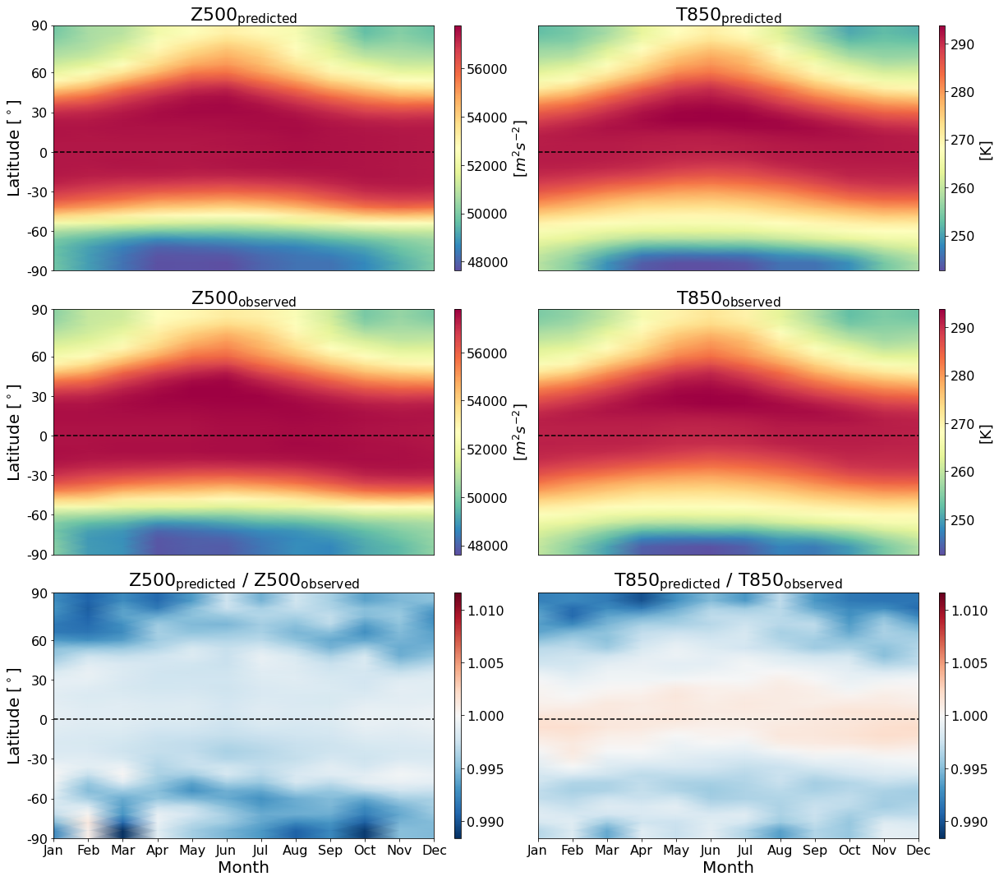

In [40]:
 
figname = figures_path + description + '_hovmoller'
plot_climatology(figname, predictions_vals, val_limits, ticks, lat_labels, month_labels)

In [41]:
import json

In [42]:
with open("../modules/confMail.json") as json_data_file:
    mailConf = json.load(json_data_file)

mail = {
    "sender": mailConf["sender"],
    "receiver": mailConf["sender"],
    "subject": "Results generated!",
    "body": "Results from model {}.\n Losses: \nZ500: t0 \t{}\t t120 \t{}\nt850: t0 \t{}\t t120 \t{} "\
    .format(description, rmse_spherical.z[0].values, rmse_spherical.z[-1].values, rmse_spherical.t[0].values, rmse_spherical.t[-1].values),
    "fileAttaching": "Yes",
    "file": [figures_path + description + '_benchmark.png', \
             figures_path + description + '_general_skills.png', \
             figures_path + description + '_0_maps.png', figures_path + description + '_19_maps.png',]


}
send_info_mail(mailInfo=mail, configFile=mailConf)

In [43]:
#import IPython

#IPython.Application.instance().kernel.do_shutdown(True)